# Pillow y OpenCV

## Importar

In [87]:
import cv2
from PIL import Image, ImageOps, ImageFilter

import os
import numpy as np
import matplotlib.pyplot as plt

## Funciones auxiliares

In [2]:
def get_concat_h(im1, im2):
    dst = Image.new('RGB', (im1.width + im2.width, im1.height))
    dst.paste(im1, (0, 0))
    dst.paste(im2, (im1.width, 0))
    return dst

In [39]:
def plot_image(image_1, image_2,title_1="Orignal",title_2="New Image"):
    plt.figure(figsize=(10,10))
    plt.subplot(1, 2, 1)
    plt.imshow(image_1,cmap="gray")
    plt.title(title_1)
    plt.subplot(1, 2, 2)
    plt.imshow(image_2,cmap="gray")
    plt.title(title_2)
    plt.show()

In [131]:
def plot_hist(old_image, new_image,title_old="Orignal", title_new="New Image"):
    intensity_values=np.array([x for x in range(256)])
    plt.subplot(1, 2, 1)
    plt.bar(intensity_values, cv2.calcHist([old_image],[0],None,[256],[0,256])[:,0],width = 5)
    plt.title(title_old)
    plt.xlabel('intensity')
    plt.subplot(1, 2, 2)
    plt.bar(intensity_values, cv2.calcHist([new_image],[0],None,[256],[0,256])[:,0],width = 5)
    plt.title(title_new)
    plt.xlabel('intensity')
    plt.show()

In [149]:
def thresholding(input_img,threshold,max_value=255, min_value=0):
    N,M=input_img.shape
    image_out=np.zeros((N,M),dtype=np.uint8)
        
    for i  in range(N):
        for j in range(M):
            if input_img[i,j]> threshold:
                image_out[i,j]=max_value
            else:
                image_out[i,j]=min_value
                
    return image_out                             

## Importar imágenes

### Pillow

In [3]:
my_image = "lenna.png"
cwd = os.getcwd()
image_path = os.path.join(cwd, my_image)
image_path

'/home/santiago/Documents/CLASE_FC2/cdigos/lenna.png'

In [4]:
image = Image.open(my_image)
type(image)

PIL.PngImagePlugin.PngImageFile

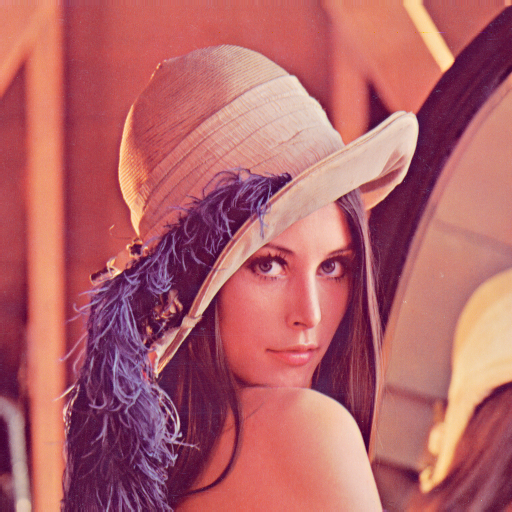

In [5]:
image #si no está en Jupyter usar .show()

In [10]:
print("El modo de la imagen es {0:s} y el tamaño {1}".format(image.mode,image.size))

El modo de la imagen es RGB y el tamaño (512, 512)


El método `Image.open` no carga la imagen en memoria. El método `load` sí. Después de cargada la imagen se puede guardar con image.save("lenna.jpg")

In [9]:
im = image.load()
x = 0
y = 1
im[y,x] #Se accede al valor del pixel en los tres canales

(226, 137, 125)

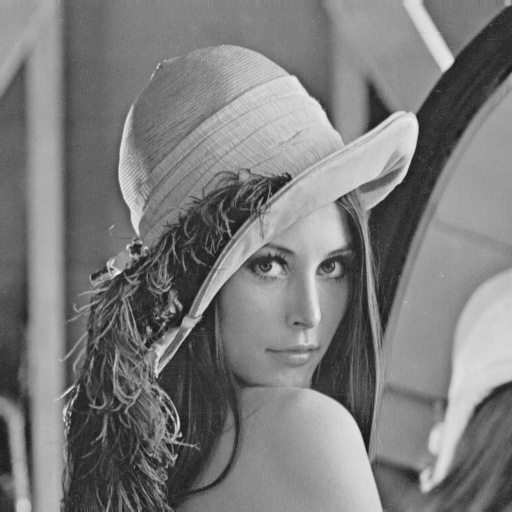

In [14]:
image_gray = ImageOps.grayscale(image) 
image_gray

In [15]:
modo_gris = image_gray.mode
print(f"El modo de una imagen en blanco y negro es {modo_gris}")

El modo de una imagen en blanco y negro es L


#### Cuantización de una imagen

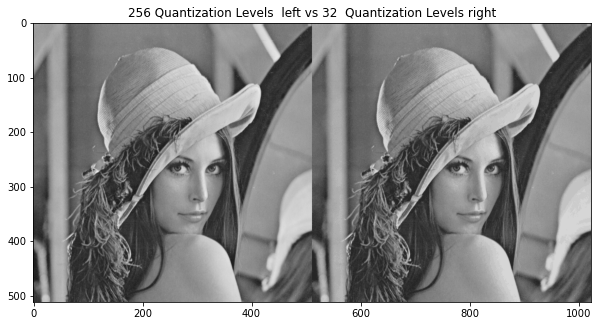

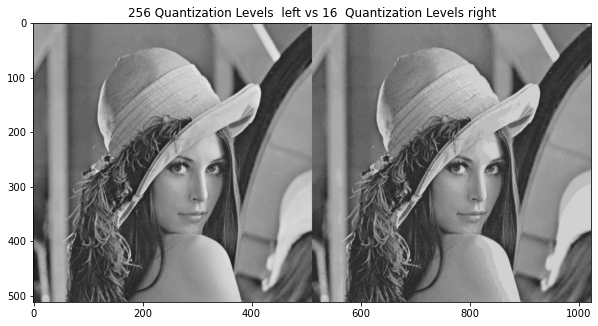

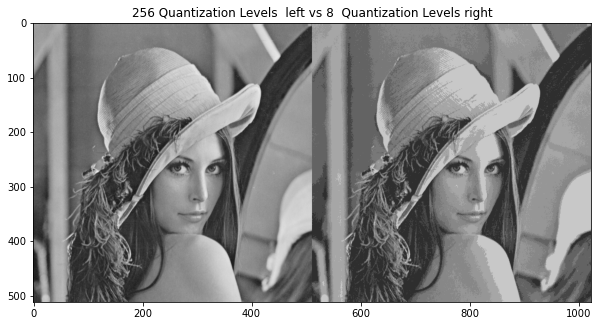

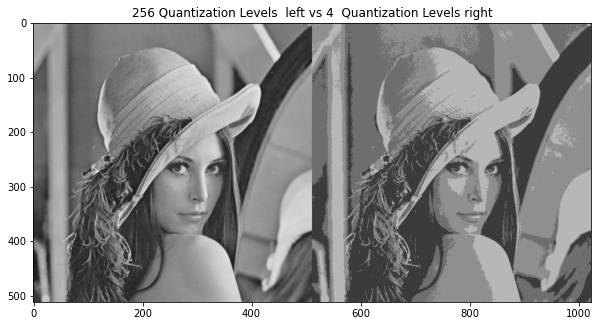

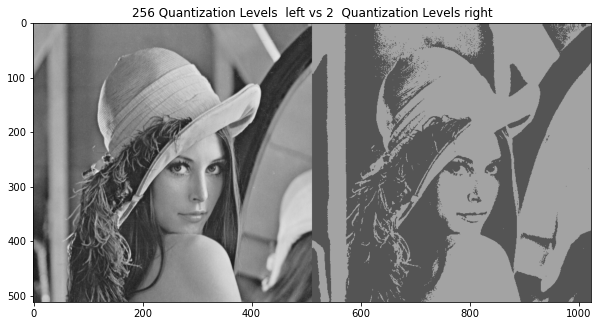

In [16]:
for n in range(3,8):
    plt.figure(figsize=(10,10))

    plt.imshow(get_concat_h(image_gray,  image_gray.quantize(256//2**n))) 
    plt.title("256 Quantization Levels  left vs {}  Quantization Levels right".format(256//2**n))
    plt.show()

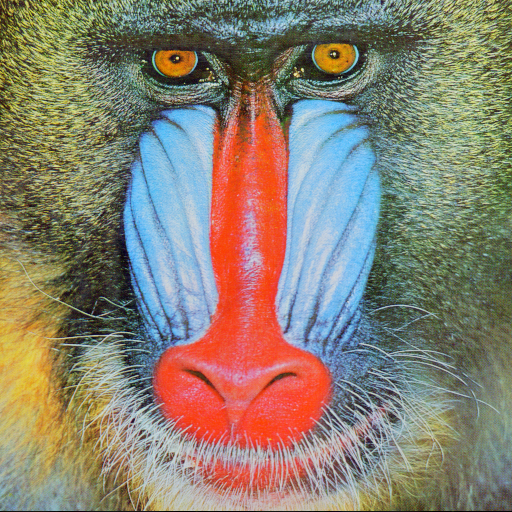

In [17]:
baboon = Image.open('baboon.png')
baboon

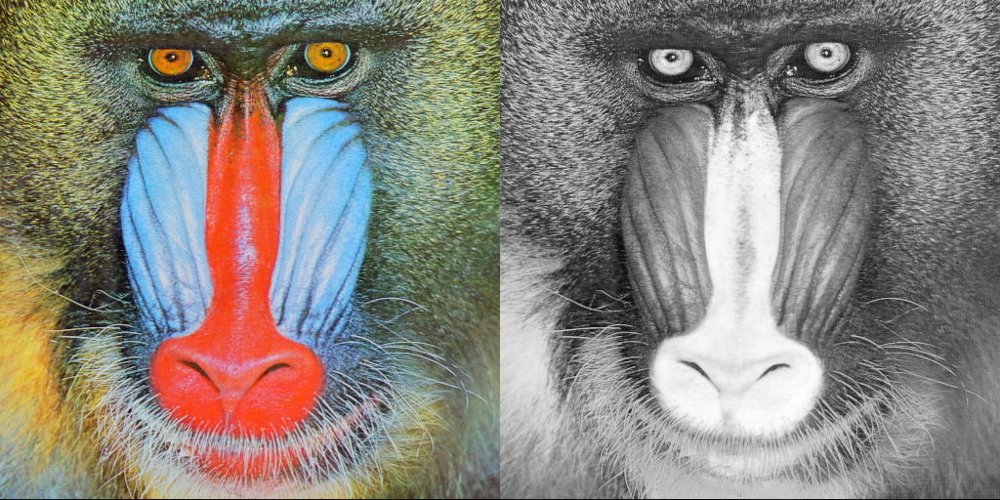

In [18]:
red, green, blue = baboon.split()
get_concat_h(baboon, red)

#### A array de numpy

In [21]:
array= np.asarray(image)
print(f"Tipo: {type(array)}\nShape:{array.shape}")

Tipo: <class 'numpy.ndarray'>
Shape:(512, 512, 3)


Para recortar las imágenes se usa la indexación de arrays

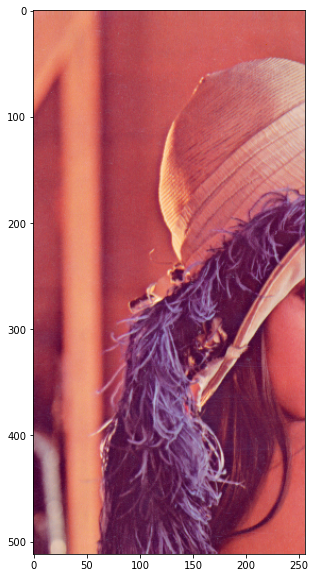

In [23]:
plt.figure(figsize=(10,10))
columns = 256
plt.imshow(array[:,0:columns,:])
plt.show()

Otra forma de graficar un solo canál sin tener que usar cmap

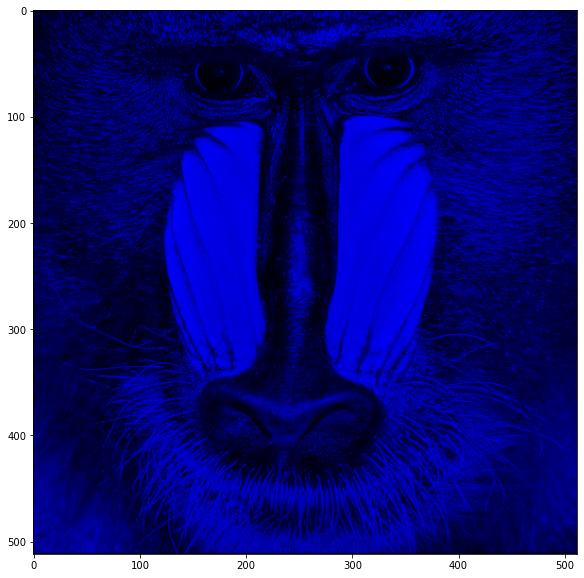

In [25]:
baboon_array = np.array(baboon)
baboon_blue=baboon_array.copy()
baboon_blue[:,:,0] = 0
baboon_blue[:,:,1] = 0
plt.figure(figsize=(10,10))
plt.imshow(baboon_blue)
plt.show()

### OpenCV

Para guardar una imágen se pone `cv2.imwrite('lena_gray_cv.jpg', image_gray)` Por defecto la imagen se carga en esquema BGR en OpenCV, por lo que hay que convertirla a RGB

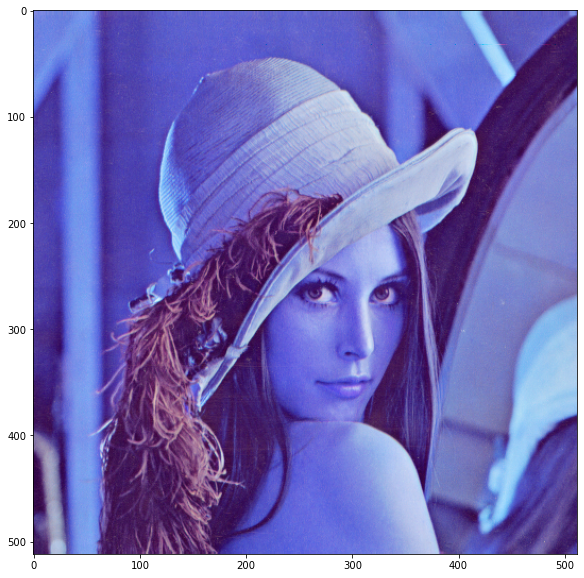

In [28]:
image = cv2.imread(my_image)
plt.figure(figsize=(10,10))
plt.imshow(image)
plt.show()

In [30]:
print(f"Tipo:{type(image)}\nTamaño:{image.shape}\nMáximo valor:{image.max()}\nMínimo Valor:{image.min()}")

Tipo:<class 'numpy.ndarray'>
Tamaño:(512, 512, 3)
Máximo valor:255
Mínimo Valor:3


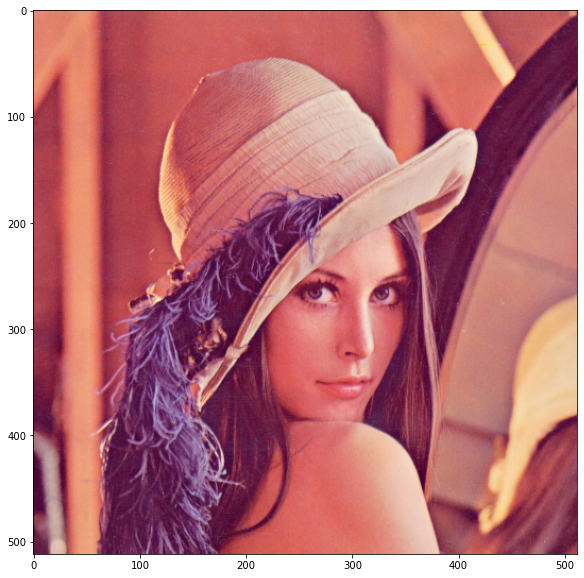

In [31]:
new_image=cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(10,10))
plt.imshow(new_image)
plt.show()

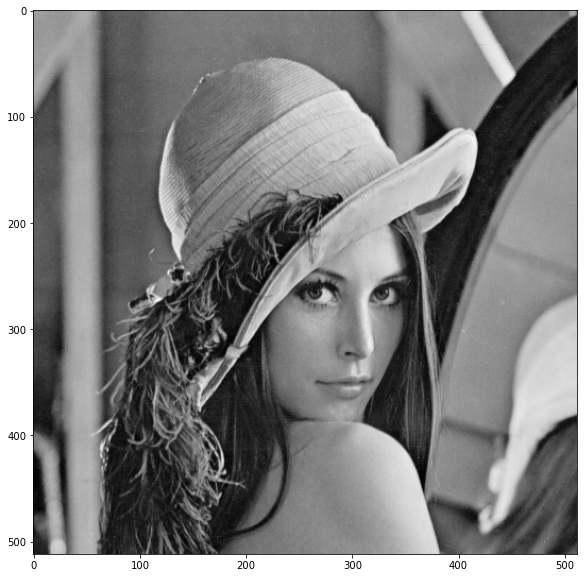

In [33]:
image_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
plt.figure(figsize=(10, 10))
plt.imshow(image_gray, cmap='gray')
plt.show()

In [34]:
image_gray.shape

(512, 512)

Al momento de visualizar se puede hacer el cambio del esquema de colores

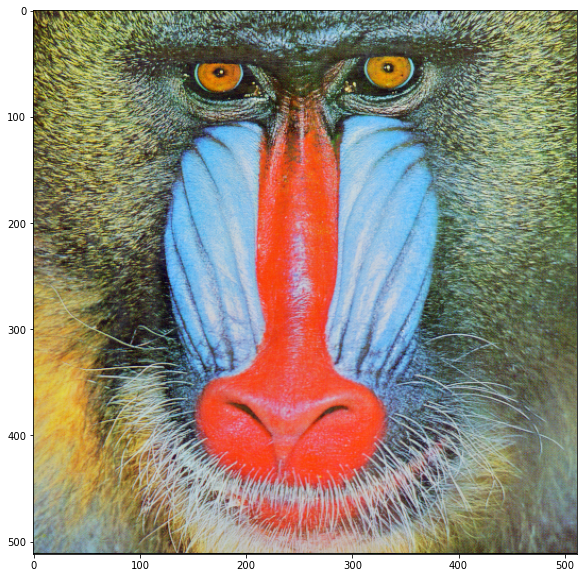

In [35]:
baboon=cv2.imread('baboon.png')
plt.figure(figsize=(10,10))
plt.imshow(cv2.cvtColor(baboon, cv2.COLOR_BGR2RGB))
plt.show()

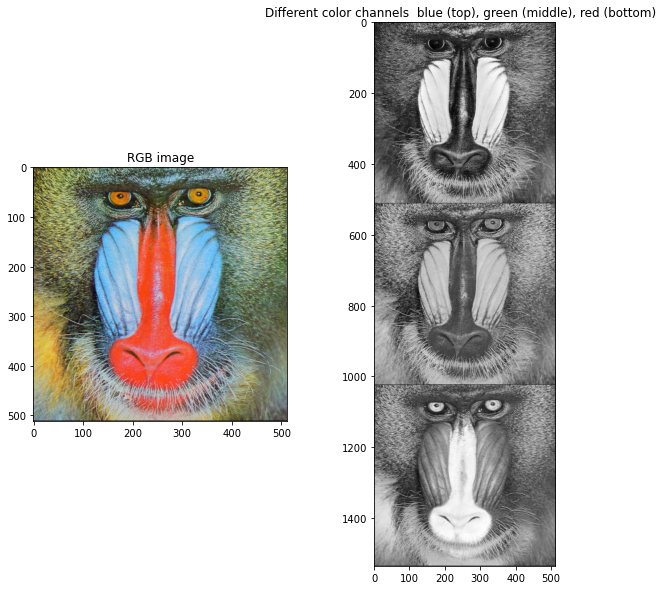

In [36]:
blue, green, red = baboon[:, :, 0], baboon[:, :, 1], baboon[:, :, 2]
im_bgr = cv2.vconcat([blue, green, red])
plt.figure(figsize=(10,10))
plt.subplot(121)
plt.imshow(cv2.cvtColor(baboon, cv2.COLOR_BGR2RGB))
plt.title("RGB image")
plt.subplot(122)
plt.imshow(im_bgr,cmap='gray')
plt.title("Different color channels  blue (top), green (middle), red (bottom)  ")
plt.show()

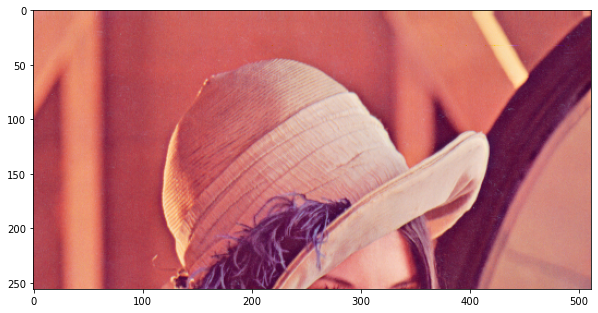

In [37]:
rows = 256
plt.figure(figsize=(10,10))
plt.imshow(new_image[0:rows,:,:])
plt.show()

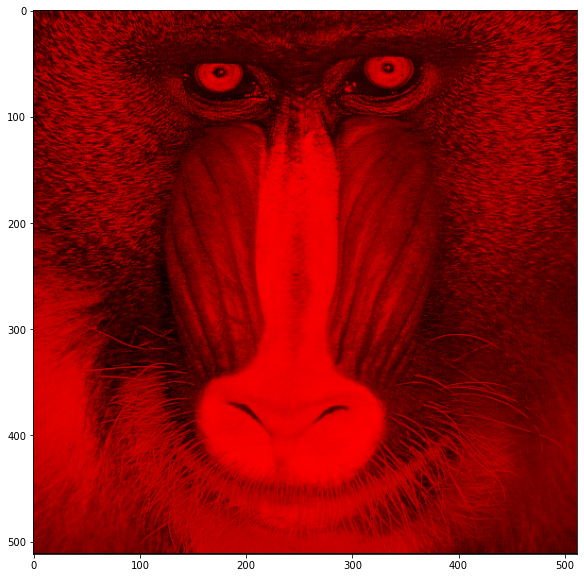

In [38]:
baboon_red = baboon.copy()
baboon_red[:, :, 0] = 0
baboon_red[:, :, 1] = 0
plt.figure(figsize=(10, 10))
plt.imshow(cv2.cvtColor(baboon_red, cv2.COLOR_BGR2RGB))
plt.show()

## Manipulando imágenes

### Pillow

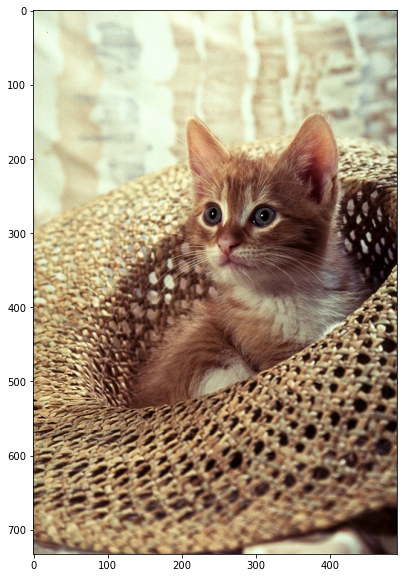

In [46]:
image = Image.open("cat.png")
plt.figure(figsize=(10,10))
plt.imshow(image)
plt.show()

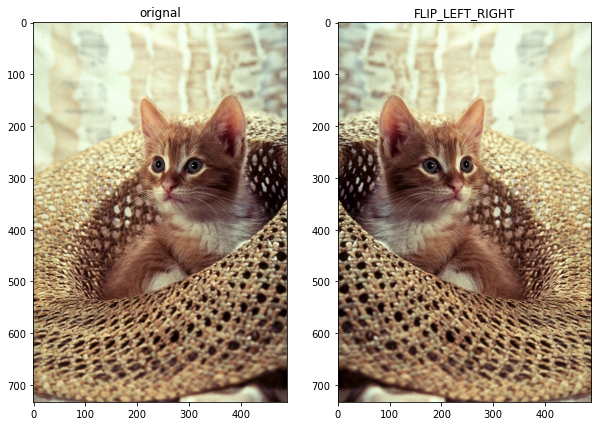

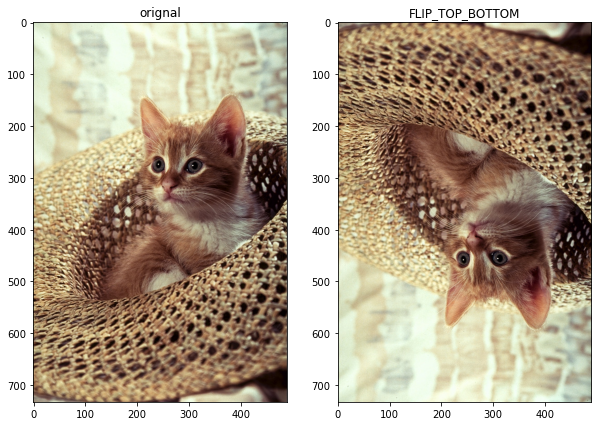

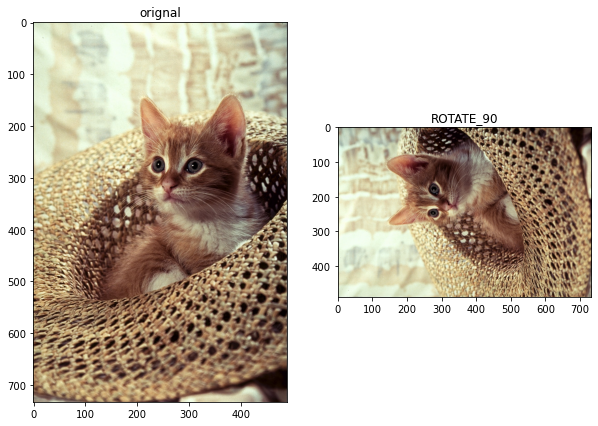

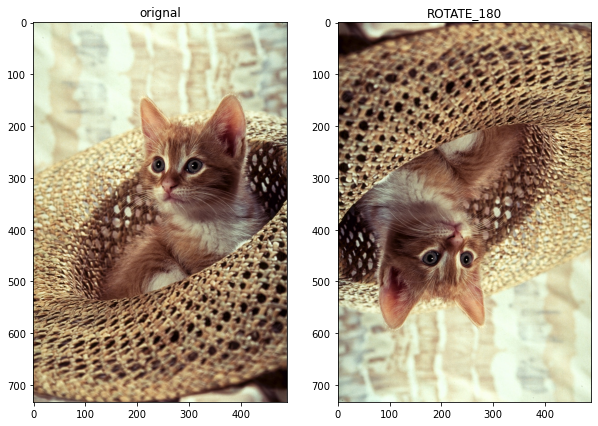

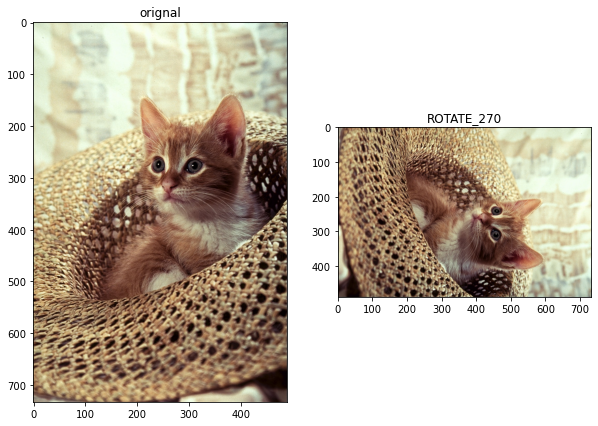

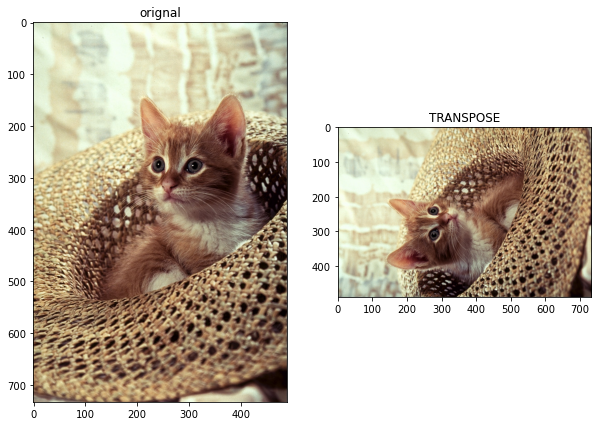

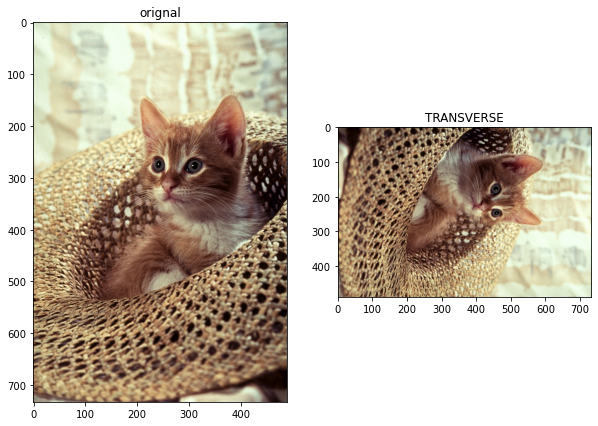

In [42]:
flip = {"FLIP_LEFT_RIGHT": Image.FLIP_LEFT_RIGHT,
        "FLIP_TOP_BOTTOM": Image.FLIP_TOP_BOTTOM,
        "ROTATE_90": Image.ROTATE_90,
        "ROTATE_180": Image.ROTATE_180,
        "ROTATE_270": Image.ROTATE_270,
        "TRANSPOSE": Image.TRANSPOSE, 
        "TRANSVERSE": Image.TRANSVERSE}
for key, values in flip.items():
    plt.figure(figsize=(10,10))
    plt.subplot(1,2,1)
    plt.imshow(image)
    plt.title("orignal")
    plt.subplot(1,2,2)
    plt.imshow(image.transpose(values))
    plt.title(key)
    plt.show()

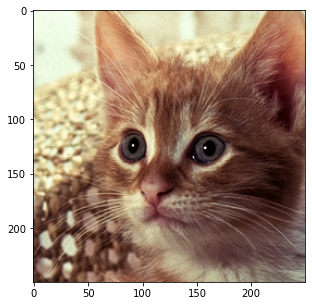

In [48]:
array = np.array(image)
left = 150
right = 400
upper = 150
lower = 400
crop_horizontal = array[upper: lower ,left:right,:]
plt.figure(figsize=(5,5))
plt.imshow(crop_horizontal)
plt.show()

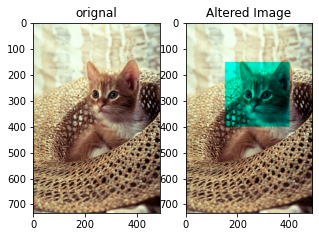

In [49]:
array_sq = np.copy(array)
array_sq[upper:lower, left:right, 0:1] = 0
plt.figure(figsize=(5,5))
plt.subplot(1,2,1)
plt.imshow(array)
plt.title("orignal")
plt.subplot(1,2,2)
plt.imshow(array_sq)
plt.title("Altered Image")
plt.show()

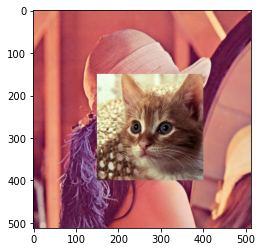

In [50]:
image_lenna = Image.open("lenna.png")
array_lenna = np.array(image_lenna)
array_lenna[upper:lower,left:right,:]=array[upper:lower,left:right,:]
plt.imshow(array_lenna)
plt.show()

### OpenCV

Para rotar una imágen en OpenCV se usa la función `flip()`, que tiene el parámetro `flipCode</code>`así:

 - `flipcode = 0`: Verticalmente respecto al eje x
 - `flipcode > 0`: Horizontalmente respecto al eje y
 - `flipcode < 0`: Los dos anteriores juntos

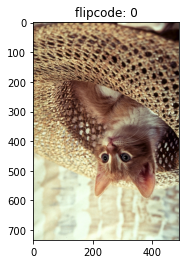

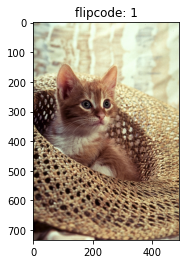

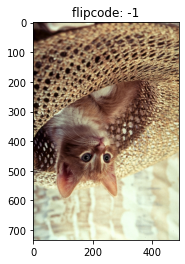

In [52]:
image = cv2.imread("cat.png")
for flipcode in [0,1,-1]:
    im_flip =  cv2.flip(image,flipcode )
    plt.imshow(cv2.cvtColor(im_flip,cv2.COLOR_BGR2RGB))
    plt.title("flipcode: "+str(flipcode))
    plt.show()

También se puede rotar pasandole a la función `rotate` el argumento correspondiente
 - cv2.ROTATE_90_CLOCKWISE
 - cv2.ROTATE_90_COUNTERCLOCKWISE
 - cv2.ROTATE_180

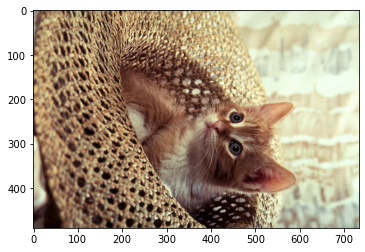

In [56]:
im_flip = cv2.rotate(image,cv2.ROTATE_90_CLOCKWISE)
plt.imshow(cv2.cvtColor(im_flip,cv2.COLOR_BGR2RGB))
plt.show()

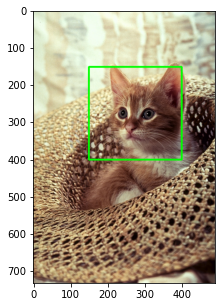

In [57]:
start_point, end_point = (left, upper),(right, lower)
image_draw = np.copy(image)
cv2.rectangle(image_draw, pt1=start_point, pt2=end_point, color=(0, 255, 0), thickness=3) 
plt.figure(figsize=(5,5))
plt.imshow(cv2.cvtColor(image_draw, cv2.COLOR_BGR2RGB))
plt.show()

## Transformaciones geométricas

### Pillow

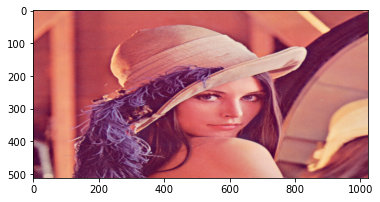

In [58]:
image = Image.open("lenna.png")
width, height = image.size
new_width = 2 * width
new_hight = height
new_image = image.resize((new_width, new_hight))
plt.imshow(new_image)
plt.show()

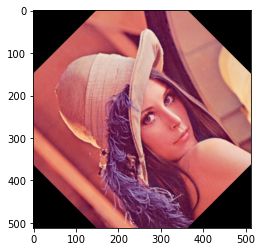

In [59]:
theta = 45
new_image = image.rotate(theta)
plt.imshow(new_image)
plt.show()

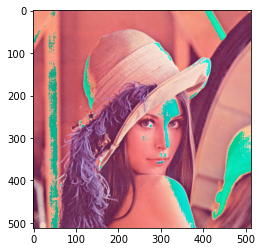

In [60]:
image = np.array(image)
new_image = image + 20
plt.imshow(new_image)
plt.show()

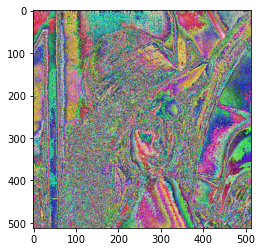

In [61]:
new_image = 10 * image
plt.imshow(new_image)
plt.show()

### OpenCV

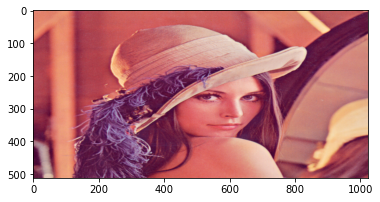

old image shape: (512, 512, 3) new image shape: (512, 1024, 3)


In [69]:
image = cv2.imread("lenna.png")
new_image = cv2.resize(image, None, fx=2, fy=1, interpolation=cv2.INTER_CUBIC)
plt.imshow(cv2.cvtColor(new_image, cv2.COLOR_BGR2RGB))
plt.show()
print("old image shape:", image.shape, "new image shape:", new_image.shape)

In [80]:
tx = 100
ty = 0
M = np.float32([[1, 0, tx], [0, 1, ty]])

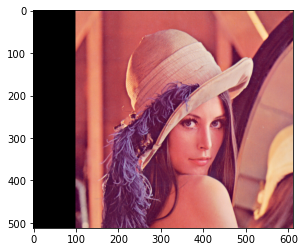

In [81]:
rows, cols, _ = image.shape
new_image = cv2.warpAffine(image, M, (cols + tx, rows + ty))
plt.imshow(cv2.cvtColor(new_image, cv2.COLOR_BGR2RGB))
plt.show()

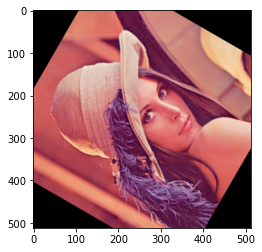

In [83]:
cols, rows, _ = image.shape
theta = 60.0
M = cv2.getRotationMatrix2D(center=(cols // 2 - 1, rows // 2 - 1), angle=theta, scale=1)
new_image = cv2.warpAffine(image, M, (cols, rows))
plt.imshow(cv2.cvtColor(new_image, cv2.COLOR_BGR2RGB))
plt.show()

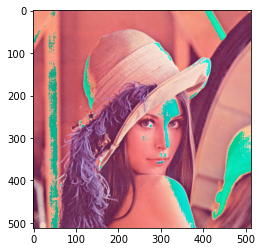

In [84]:
new_image = image + 20

plt.imshow(cv2.cvtColor(new_image, cv2.COLOR_BGR2RGB))
plt.show()

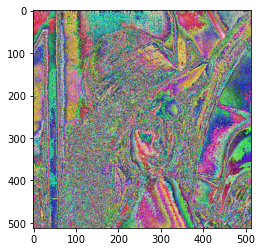

In [85]:
new_image = 10 * image
plt.imshow(cv2.cvtColor(new_image, cv2.COLOR_BGR2RGB))
plt.show()

## Filtros

### Pillow

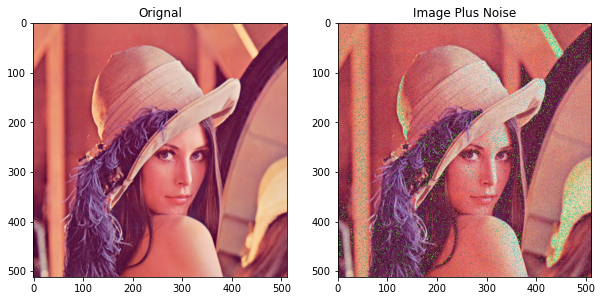

In [88]:
image = Image.open("lenna.png")
rows, cols = image.size

noise = np.random.normal(0,15,(rows,cols,3)).astype(np.uint8)
noisy_image = image + noise
noisy_image = Image.fromarray(noisy_image)

plot_image(image, noisy_image, title_1="Orignal", title_2="Image Plus Noise")

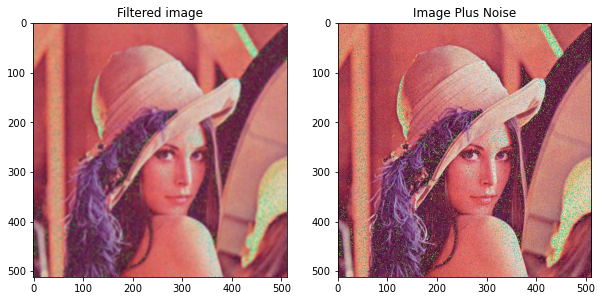

In [89]:
kernel = np.ones((5,5))/36
# Para crear el Kernel se pasa el tamaño del kernel y un kernel aplanado
kernel_filter = ImageFilter.Kernel((5,5), kernel.flatten())

image_filtered = noisy_image.filter(kernel_filter)

plot_image(image_filtered, noisy_image,title_1="Filtered image",title_2="Image Plus Noise")

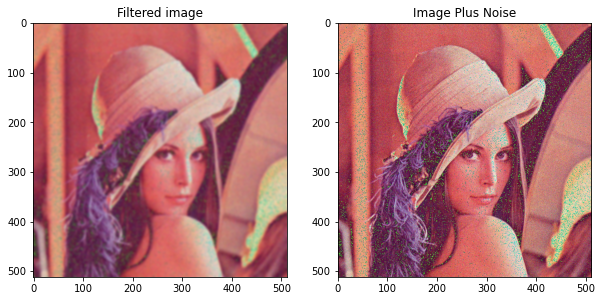

In [93]:
# Filters the images using GaussianBlur
image_filtered = noisy_image.filter(ImageFilter.GaussianBlur(radius = 2))
# Plots the Filtered Image then the Unfiltered Image with Noise
plot_image(image_filtered , noisy_image,title_1="Filtered image",title_2="Image Plus Noise")

Image Sharpening consiste en suavizar la imagen y calcular las derivadas. Podemos lograr la nitidez de la imagen aplicando el siguiente Kernel.

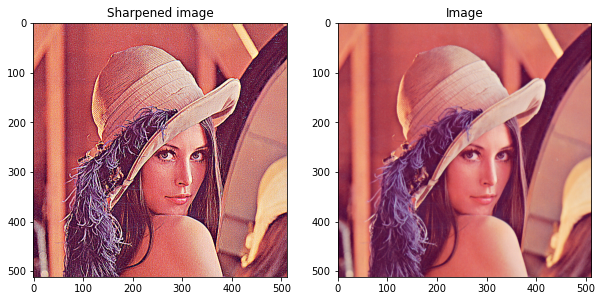

In [94]:
kernel = np.array([[-1,-1,-1], 
                   [-1, 9,-1],
                   [-1,-1,-1]])
kernel = ImageFilter.Kernel((3,3), kernel.flatten())

sharpened = image.filter(kernel)

plot_image(sharpened , image, title_1="Sharpened image",title_2="Image")

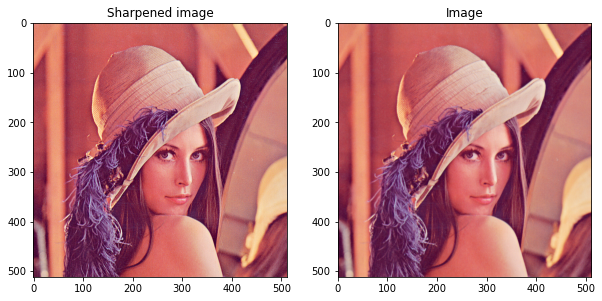

In [95]:
sharpened = image.filter(ImageFilter.SHARPEN)

plot_image(sharpened , image, title_1="Sharpened image",title_2="Image")

<Figure size 720x720 with 0 Axes>

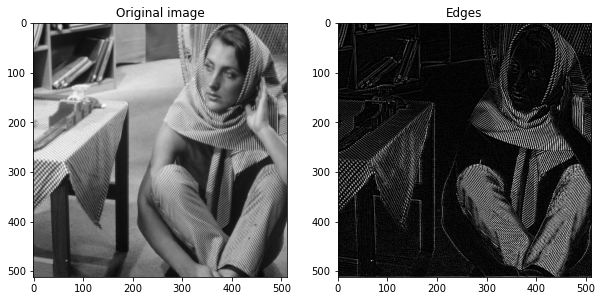

In [98]:
img_gray = Image.open('barbara.png')

img_gray_edges = img_gray.filter(ImageFilter.FIND_EDGES)

plt.figure(figsize=(10,10))

plot_image(img_gray , img_gray_edges, title_1="Original image",title_2="Edges")

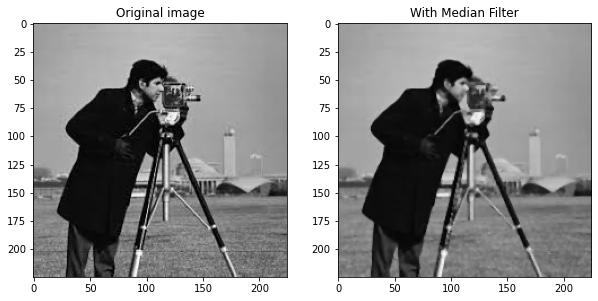

In [99]:
image = Image.open("cameraman.jpeg")

image_median = image.filter(ImageFilter.MedianFilter)

plot_image(image , image_median, title_1="Original image",title_2="With Median Filter")

### OpenCV

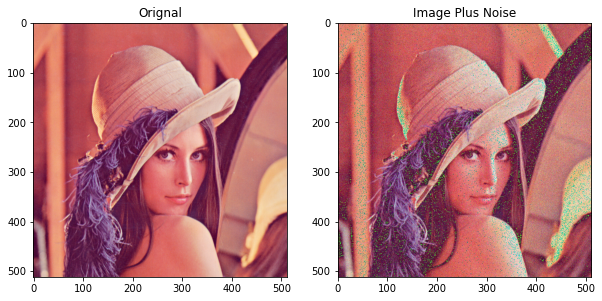

In [106]:
image = cv2.cvtColor(cv2.imread("lenna.png"), cv2.COLOR_BGR2RGB)

rows, cols,_= image.shape

noise = np.random.normal(0,15,(rows,cols,3)).astype(np.uint8)

noisy_image = image + noise

plot_image(image, noisy_image, title_1="Orignal",title_2="Image Plus Noise")

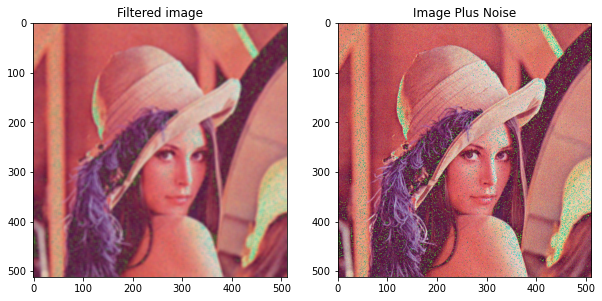

In [114]:
kernel = np.ones((6,6))/36
image_filtered = cv2.filter2D(src=noisy_image, ddepth=-1, kernel=kernel)
#ddepth=-1 para tener la misma profundidad que la imagen original
plot_image(image_filtered, noisy_image,title_1="Filtered image",title_2="Image Plus Noise")

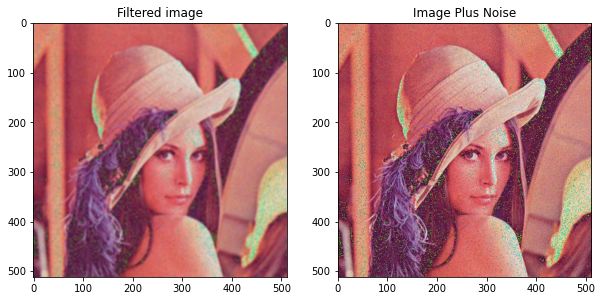

In [115]:
image_filtered = cv2.GaussianBlur(noisy_image,(5,5),sigmaX=4,sigmaY=4)

plot_image(image_filtered , noisy_image,title_1="Filtered image",title_2="Image Plus Noise")

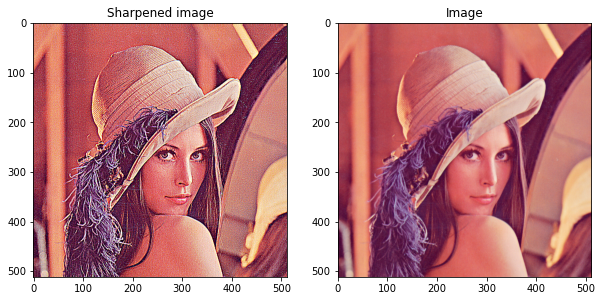

In [116]:
kernel = np.array([[-1,-1,-1], 
                   [-1, 9,-1],
                   [-1,-1,-1]])

sharpened = cv2.filter2D(image, -1, kernel)

plot_image(sharpened , image, title_1="Sharpened image",title_2="Image")

[[181 201 202 ... 103 102  92]
 [171 198 201 ...  94  96  96]
 [175 195 193 ...  87  96  98]
 ...
 [100  97  97 ... 114 113 117]
 [ 94  97  99 ... 111 112 114]
 [ 96  95  98 ... 113 104 109]]


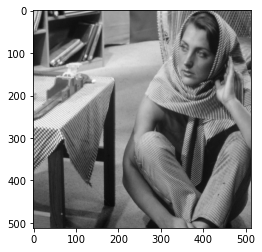

In [117]:
img_gray = cv2.imread('barbara.png', cv2.IMREAD_GRAYSCALE)
print(img_gray)

plt.imshow(img_gray ,cmap='gray')

- `ddepth`: Asociado con el tamaño en memoria de los valores de los pixeles
- `ksize`: Tamaño del kernel
- `dx`: Orden de la derivada en x
- `dy`: Orden de la derivada en y

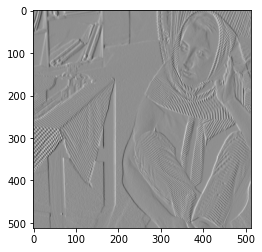

In [123]:
ddepth = cv2.CV_16S

grad_x = cv2.Sobel(src=img_gray, ddepth=ddepth, dx=1, dy=0, ksize=3)
grad_y = cv2.Sobel(src=img_gray, ddepth=ddepth, dx=0, dy=1, ksize=3)
plt.imshow(grad_x,cmap='gray')

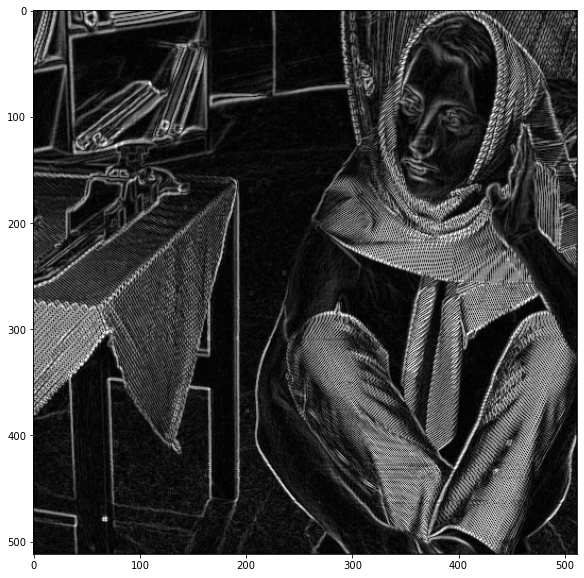

In [125]:
# Convierte nuevamente a un valor entre 0 y 255
abs_grad_x = cv2.convertScaleAbs(grad_x)
abs_grad_y = cv2.convertScaleAbs(grad_y)
#Suma los gradientes
grad = cv2.addWeighted(abs_grad_x, 0.5, abs_grad_y, 0.5, 0)
#Grafica
plt.figure(figsize=(10,10))
plt.imshow(grad,cmap='gray')

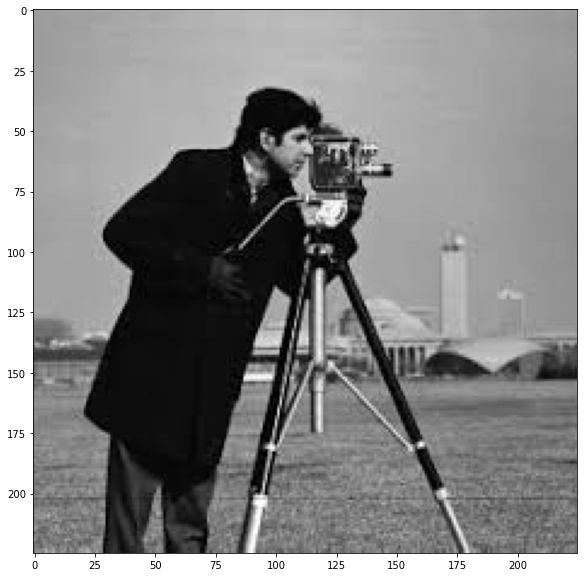

In [127]:
image = cv2.imread("cameraman.jpeg",cv2.IMREAD_GRAYSCALE)

plt.figure(figsize=(10,10))

plt.imshow(image,cmap="gray")

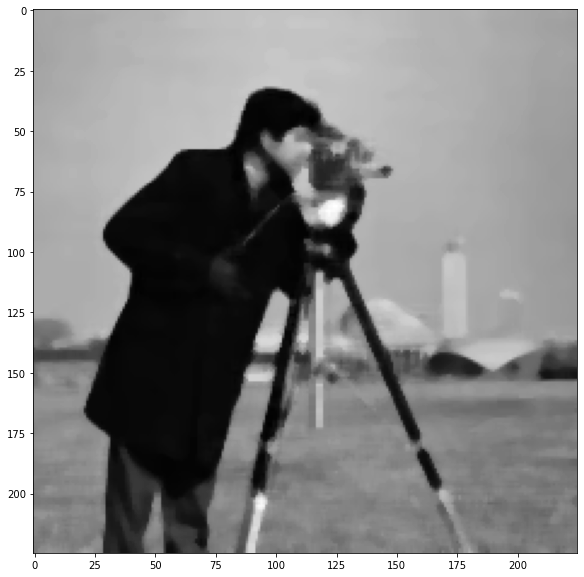

In [128]:
# Median Blurr con kernel de tamaño 5
filtered_image = cv2.medianBlur(image, 5)

plt.figure(figsize=(10,10))

plt.imshow(filtered_image,cmap="gray")

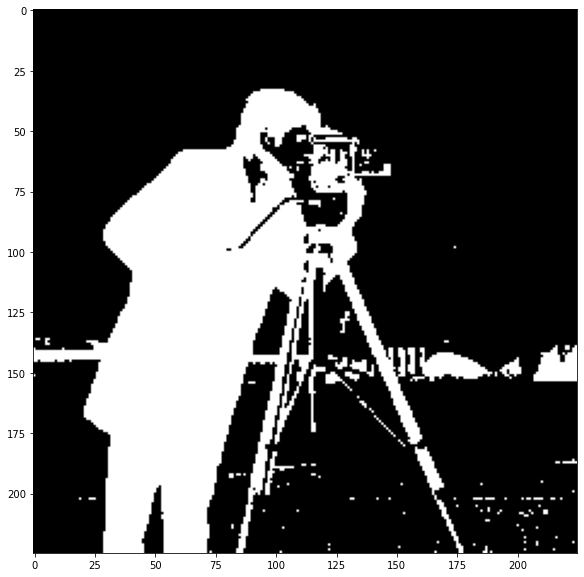

In [130]:
# Retorna el umbral "óptimo"
ret, outs = cv2.threshold(src = image, thresh = 0, maxval = 255, type = cv2.THRESH_OTSU+cv2.THRESH_BINARY_INV)


plt.figure(figsize=(10,10))


plt.imshow(outs, cmap='gray')

## Histogramas

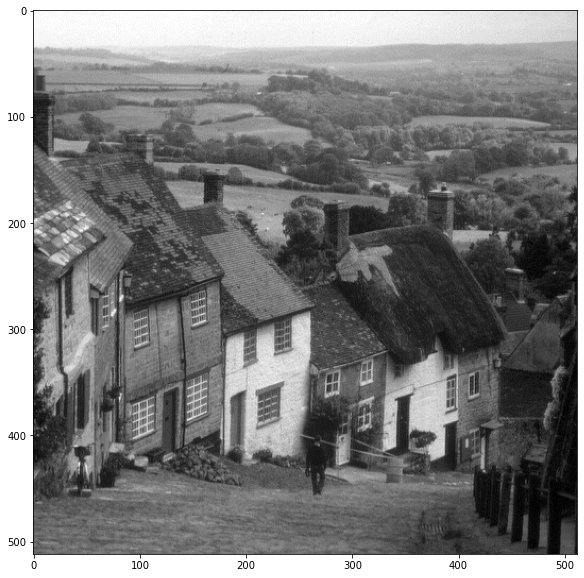

In [132]:
goldhill = cv2.imread("goldhill.bmp",cv2.IMREAD_GRAYSCALE)
plt.figure(figsize=(10,10))
plt.imshow(goldhill,cmap="gray")
plt.show()

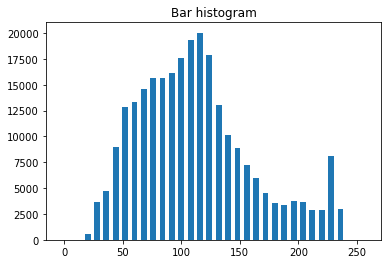

In [135]:
hist = cv2.calcHist([goldhill],[0], None, [256], [0,256])
intensity_values = np.array([x for x in range(hist.shape[0])])
plt.bar(intensity_values, hist[:,0], width = 5)
plt.title("Bar histogram")
plt.show()

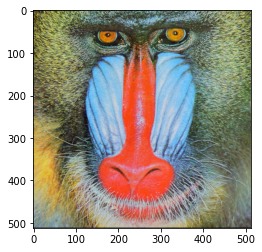

In [136]:
baboon = cv2.imread("baboon.png")
plt.imshow(cv2.cvtColor(baboon,cv2.COLOR_BGR2RGB))
plt.show()

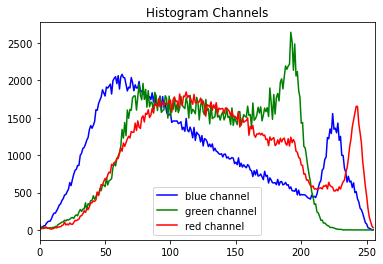

In [137]:
color = ('blue','green','red')
for i,col in enumerate(color):
    histr = cv2.calcHist([baboon],[i],None,[256],[0,256])
    plt.plot(intensity_values,histr,color = col,label=col+" channel")
    
    plt.xlim([0,256])
plt.legend()
plt.title("Histogram Channels")
plt.show()

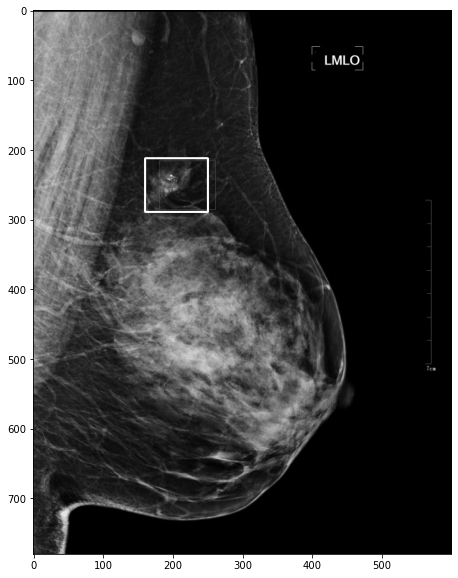

In [138]:
image = cv2.imread("mammogram.png", cv2.IMREAD_GRAYSCALE)
cv2.rectangle(image, pt1=(160, 212), pt2=(250, 289), color = (255), thickness=2) 

plt.figure(figsize = (10,10))
plt.imshow(image, cmap="gray")
plt.show()

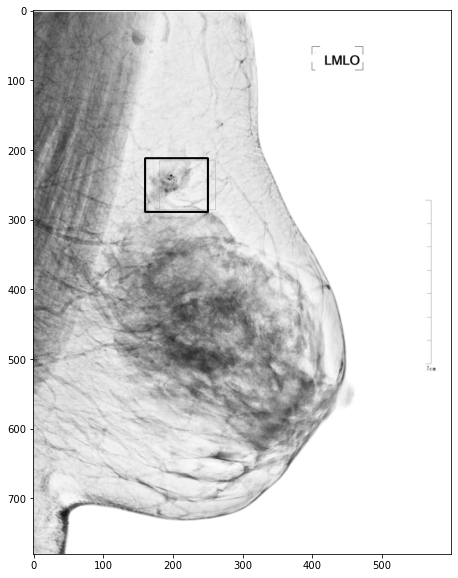

In [139]:
img_neg = -1 * image + 255
plt.figure(figsize=(10,10))
plt.imshow(img_neg, cmap = "gray")
plt.show()

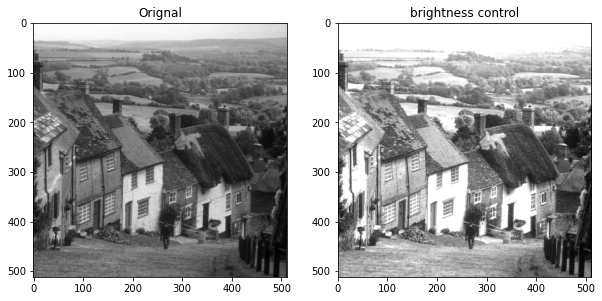

In [140]:
alpha = 1 # Simple contrast control
beta = 100   # Simple brightness control   
new_image = cv2.convertScaleAbs(goldhill, alpha=alpha, beta=beta)
plot_image(goldhill, new_image, title_1 = "Orignal", title_2 = "brightness control")

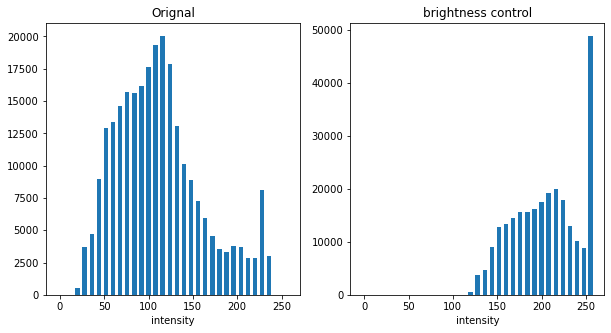

In [141]:
plt.figure(figsize=(10,5))
plot_hist(goldhill, new_image, "Orignal", "brightness control")

<Figure size 720x360 with 0 Axes>

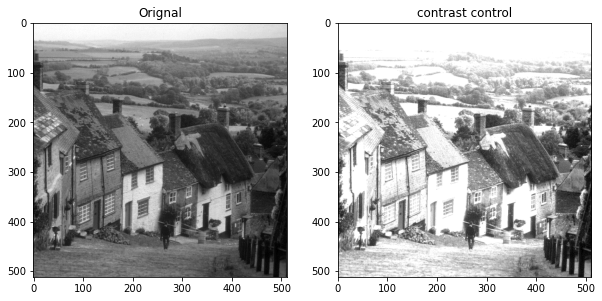

In [142]:
plt.figure(figsize=(10,5))
alpha = 2# Simple contrast control
beta = 0 # Simple brightness control   # Simple brightness control
new_image = cv2.convertScaleAbs(goldhill, alpha=alpha, beta=beta)
plot_image(goldhill,new_image,"Orignal","contrast control")

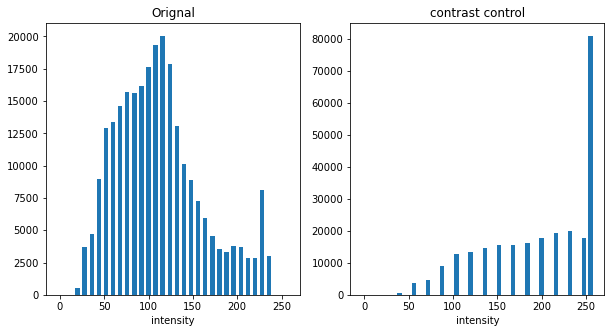

In [143]:
plt.figure(figsize=(10,5))
plot_hist(goldhill, new_image,"Orignal","contrast control")

<Figure size 720x360 with 0 Axes>

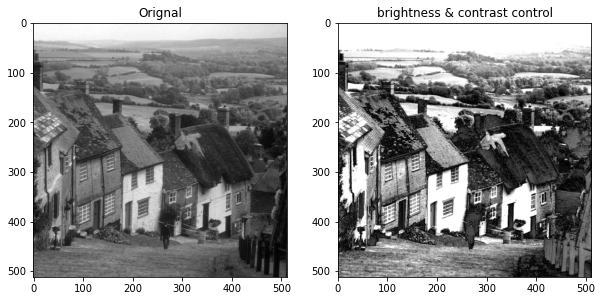

In [144]:
plt.figure(figsize=(10,5))
alpha = 3 # Simple contrast control
beta = -200  # Simple brightness control   
new_image = cv2.convertScaleAbs(goldhill, alpha=alpha, beta=beta)
plot_image(goldhill, new_image, "Orignal", "brightness & contrast control")

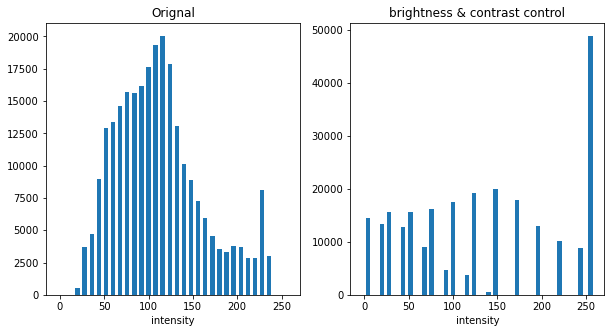

In [145]:
plt.figure(figsize=(10,5))
plot_hist(goldhill, new_image, "Orignal", "brightness & contrast control")

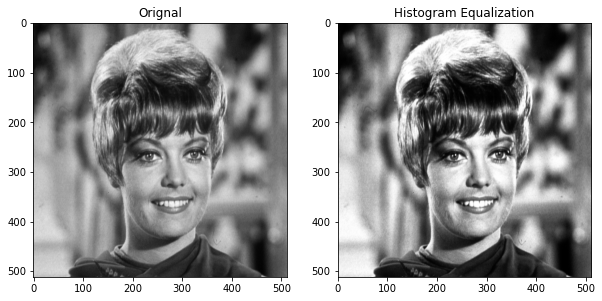

In [147]:
zelda = cv2.imread("zelda.png",cv2.IMREAD_GRAYSCALE)
new_image = cv2.equalizeHist(zelda)
plot_image(zelda,new_image,"Orignal","Histogram Equalization")

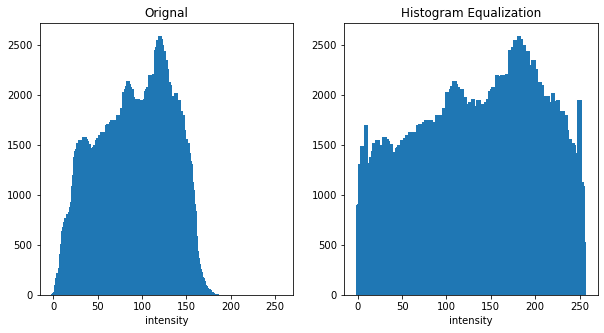

In [148]:
plt.figure(figsize=(10,5))
plot_hist(zelda, new_image,"Orignal","Histogram Equalization")

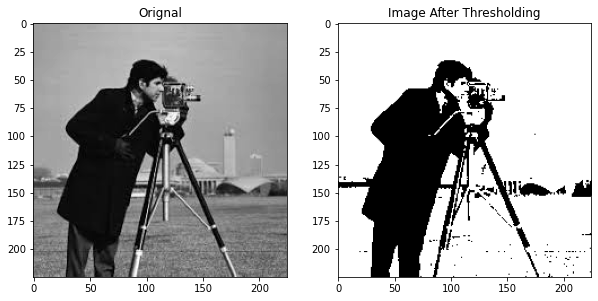

In [157]:
image = cv2.imread("cameraman.jpeg", cv2.IMREAD_GRAYSCALE)
threshold = 87
max_value = 255
min_value = 0
new_image = thresholding(image, threshold=threshold, max_value=max_value, min_value=min_value)
plot_image(image, new_image, "Orignal", "Image After Thresholding")

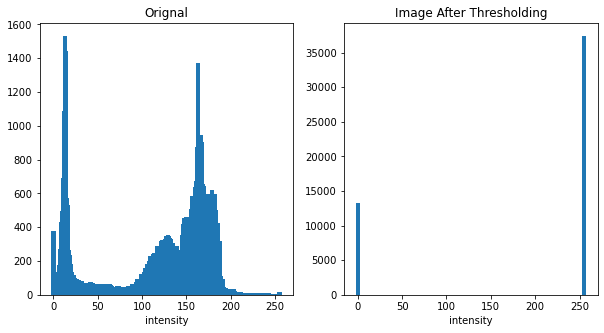

In [156]:
plt.figure(figsize=(10,5))
plot_hist(image, new_image, "Orignal", "Image After Thresholding")

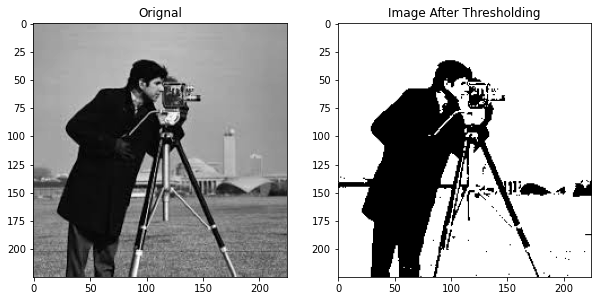

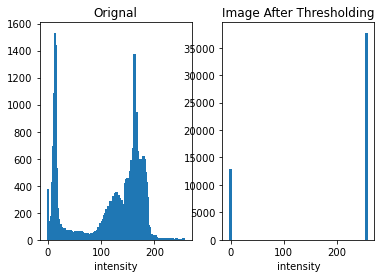

In [164]:
threshold = 80
ret, new_image = cv2.threshold(image,threshold,max_value,cv2.THRESH_BINARY)
plot_image(image,new_image,"Orignal","Image After Thresholding")
plot_hist(image, new_image,"Orignal","Image After Thresholding")

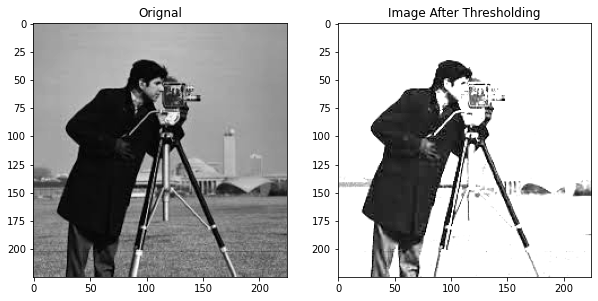

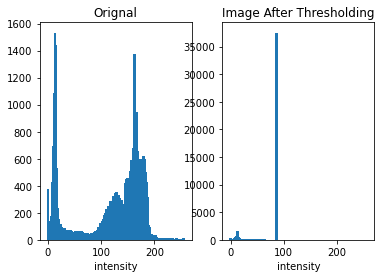

In [159]:
ret, new_image = cv2.threshold(image,86,255,cv2.THRESH_TRUNC) #NO CAMBIA VALORES SI LOS PIXELES SON MENORES AL UMBRAL
plot_image(image,new_image,"Orignal","Image After Thresholding")
plot_hist(image, new_image,"Orignal","Image After Thresholding")

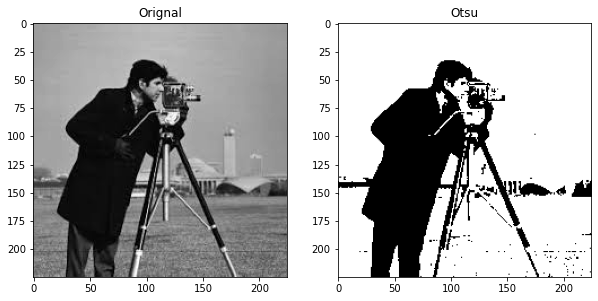

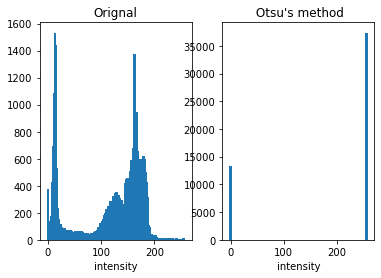

In [162]:
ret, otsu = cv2.threshold(image,0,255,cv2.THRESH_OTSU) #Determina el valor óptimo del histograma
plot_image(image,otsu,"Orignal","Otsu")
plot_hist(image, otsu,"Orignal"," Otsu's method")

<a href="https://docs.opencv.org/4.x/d7/d1b/group__imgproc__misc.html#ggaa9e58d2860d4afa658ef70a9b1115576a147222a96556ebc1d948b372bcd7ac59" target="_blank">Aprender más de los tipos de thresholding que hay en OpenCV</a>